# **15-9. 프로젝트 : 다양한 OCR모델 비교하기 🆎**
우리는 지금까지 Google OCR API, keras-ocr, Tesseract 이상 3가지의 OCR 기능을 간단히 활용하여 보았습니다.  

지금까지 살펴본 바로는 무료로 사용할 수 있는 기능들이지만 모두 준수한 성능을 갖추고 있었습니다. OCR 분야가 이미 실용적인 수준에까지 기술이 발전했기 때문에 이런 것들만 잘 활용해도 실전에 활용할 수 있는 좋은 서비스를 만들어 낼 수 있을 것도 같습니다. 그런데 과연 어떤 것을 사용하는 것이 좋을까요?  

OCR 기술들이 실용적인 수준까지 꽤 발전했지만 그럼에도 불구하고 아직 완전한 수준은 아닙니다. 용도에 맞게 적절한 것을 선택하는 것도 중요한 일입니다. 그래서 오늘 다뤄본 위 3가지를 검증해 보는 프로젝트를 진행하겠습니다. 여러분은 **OCR 기능을 활용한 서비스를 빠르게 개발해야 하는 임무를 맡은 엔지니어가 되어, 어떤 모듈을 도입하면 좋을지 기술검증을 하는 역할을 맡게 되었다고 가정**합니다.  

프로젝트를 시작하기 전에 주요 라이브러리 버전을 살펴보죠.

In [ ]:
#!pip install keras_ocr=='0.8.8'


In [ ]:
#!pip install pytesseract=='0.3.8'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for pytesseract: filename=pytesseract-0.3.8-py2.py3-none-any.whl size=14070 sha256=6fd3623ada5658f9cf751b1caec7f31214cd4083ae8c657463a759e33a01b429
  Stored in directory: /root/.cache/pip/wheels/a4/89/b9/3f11250225d0f90e5454fcc30fd1b7208db226850715aa9ace
Successfully built pytesseract
  Attempting uninstall: pytesseract
    Found existing installation: pytesseract 0.3.10
    Uninstalling pytesseract-0.3.10:
      Successfully uninstalled pytesseract-0.3.10


In [2]:
import keras_ocr
import pytesseract
import os

print(keras_ocr.__version__)
print(pytesseract.__version__)
# pytesseract는 tesseract-ocr에 종속적입니다. 아래 명령어를 통해 설치해야 할 수도 있습니다.
# !sudo apt install tesseract-ocr

# lms 0.8.8, 0.3.8

0.8.8
0.3.8


## **Step1. 검증용 데이터셋 준비**
OCR 관련해서 오늘 다루어본 주제는 텍스트의 모양과 크기, 배치, 노이즈 등 OCR의 성능에 영향을 미치는 요인들에 관한 것이었습니다. 여러분들은 위 3가지 기능들이 이미지에 나타난 특징에 따라 얼마나 정확하게 문자를 detect하고 recognize하는지를 검증하기 위한 이미지 데이터를 모아야 합니다. 이미지가 많을수록 좋겠지만 검증해야 할 항목별로 고루 갖춰지는 것도 중요합니다.

가능하다면 함께 학습하는 동료들과 힘을 합쳐보는 것을 추천합니다. 그렇다고 너무 많은 이미지 데이터로 검증하는 것은 이후 결과를 정리하는 것이 힘들 수 있으니 테스트용 이미지는 아무리 많아도 20장을 넘기지 않는 것으로 합시다.

## **Step2. keras-ocr, Tesseract로 테스트 진행(Google OCR API는 선택 사항)**
위 두 가지 모듈을 활용하는 방법에 대해서는 코드 레벨로 이미 경험해 보셨을 것입니다. 이미지 리스트를 정리한 후 반복문을 실행하며 모듈이 출력한 결과를 모아 봅시다. 가능하다면 Google OCR API를 포함해 세 가지 모듈을 다 써보세요.

### Keras-ocr

In [5]:
import matplotlib.pyplot as plt
import keras_ocr

# keras-ocr이 detector과 recognizer를 위한 모델을 자동으로 다운로드받게 됩니다. 
pipeline = keras_ocr.pipeline.Pipeline()

Looking for /aiffel/.keras-ocr/craft_mlt_25k.h5
Looking for /aiffel/.keras-ocr/crnn_kurapan.h5


In [3]:
image_urls = [
'https://user-images.githubusercontent.com/108614874/189377704-8385d30d-dc69-4aef-bd75-936f94abd757.png'
,'https://user-images.githubusercontent.com/108614874/189377799-3fa00622-1920-44c4-b67c-9601f592c3d2.png'
,'https://user-images.githubusercontent.com/108614874/190158224-69ef8c1c-bafe-401f-af1c-bb1356a22aa2.jpg'

    
]


images = [ keras_ocr.tools.read(url) for url in image_urls]
prediction_groups = [pipeline.recognize([url]) for url in image_urls]

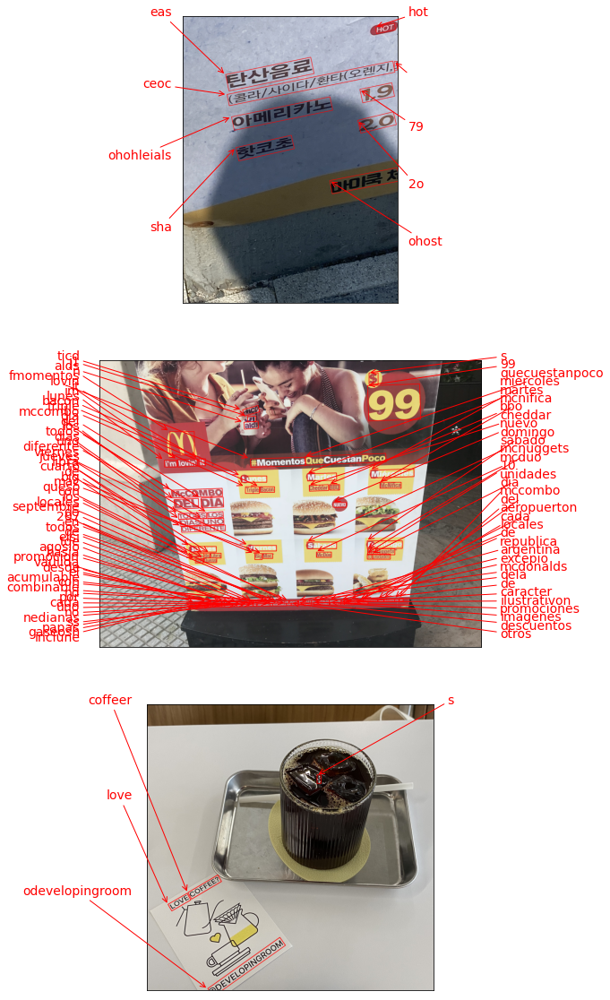

In [4]:
# Plot the predictions
fig, axs = plt.subplots(nrows=len(images), figsize=(20, 20))
for idx, ax in enumerate(axs):
    keras_ocr.tools.drawAnnotations(image=images[idx], 
                                    predictions=prediction_groups[idx][0], ax=ax)

In [5]:
image_urls = [
'https://user-images.githubusercontent.com/108614874/190158538-f3dd9e55-4cad-4a21-8c40-76276dd3c611.jpg'
,'https://user-images.githubusercontent.com/108614874/190158607-e0b59684-0a44-4dd3-879c-265e4e7df169.jpg'
,'https://user-images.githubusercontent.com/108614874/190158722-c7fb7f49-3763-4497-8a8f-032617c0c734.jpg'

    
]


images = [ keras_ocr.tools.read(url) for url in image_urls]
prediction_groups = [pipeline.recognize([url]) for url in image_urls]

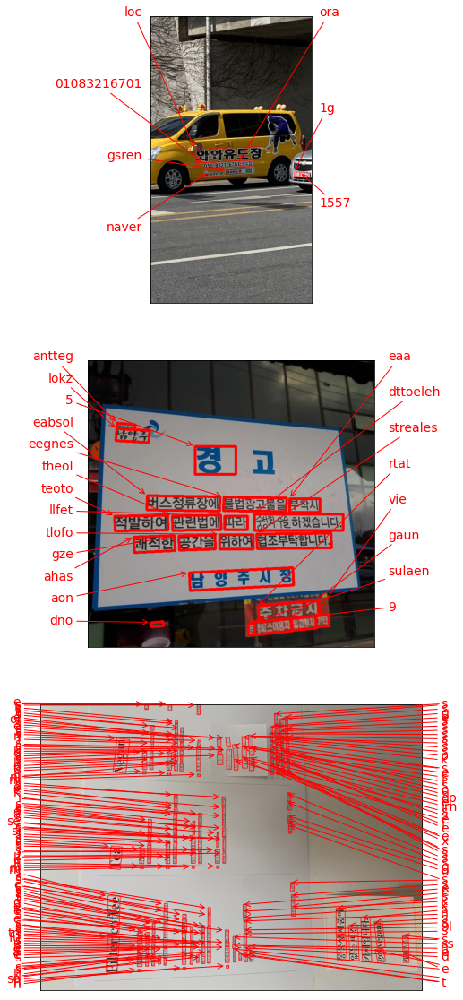

In [6]:
# Plot the predictions
fig, axs = plt.subplots(nrows=len(images), figsize=(20, 20))
for idx, ax in enumerate(axs):
    keras_ocr.tools.drawAnnotations(image=images[idx], 
                                    predictions=prediction_groups[idx][0], ax=ax)

In [6]:
image_urls = [
'https://user-images.githubusercontent.com/108614874/190158760-331cd2f0-4927-475b-b59a-c8287ae81b45.jpg'
,'https://user-images.githubusercontent.com/108614874/190158793-e96d8005-84fe-4339-af1c-fa61f8685ba2.jpg'
,'https://user-images.githubusercontent.com/108614874/190158794-52535564-c6a6-4da8-a4d6-af5e3070db71.jpg'    


    
]


images = [ keras_ocr.tools.read(url) for url in image_urls]
prediction_groups = [pipeline.recognize([url]) for url in image_urls]


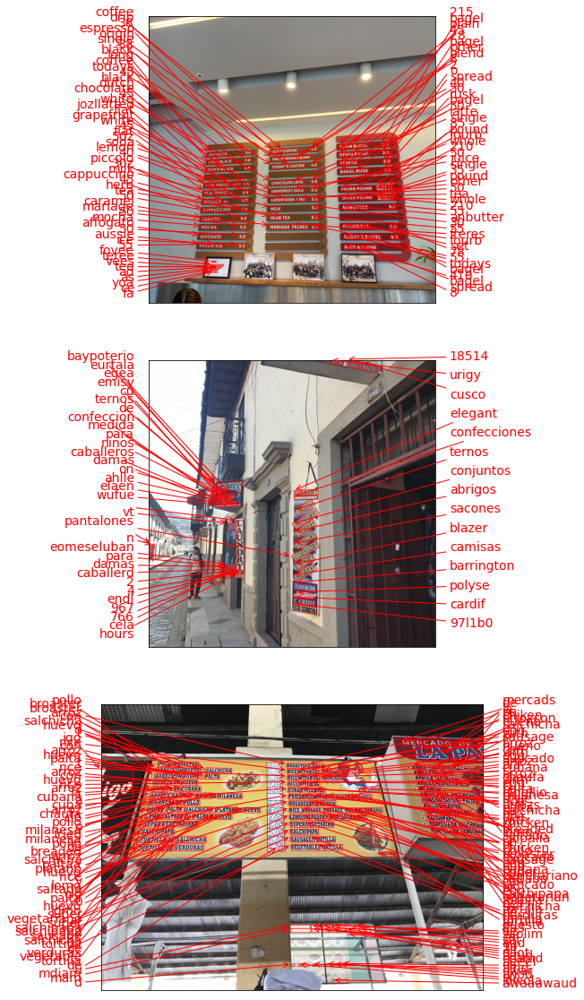

In [7]:
# Plot the predictions
fig, axs = plt.subplots(nrows=len(images), figsize=(20, 20))
for idx, ax in enumerate(axs):
    keras_ocr.tools.drawAnnotations(image=images[idx], 
                                    predictions=prediction_groups[idx][0], ax=ax)

In [8]:
image_urls = [
'https://user-images.githubusercontent.com/108614874/190158857-b597f161-ca0c-46ac-b2c5-f44336ea2ee6.jpg'
,'https://user-images.githubusercontent.com/108614874/190158920-9cc64b44-ffee-46a5-8a36-cfa00c21b687.jpg'
,'https://user-images.githubusercontent.com/108614874/190158911-eb9e8c83-9416-4f85-a19c-ebe9d40e3798.jpg'

    
]


images = [ keras_ocr.tools.read(url) for url in image_urls]
prediction_groups = [pipeline.recognize([url]) for url in image_urls]


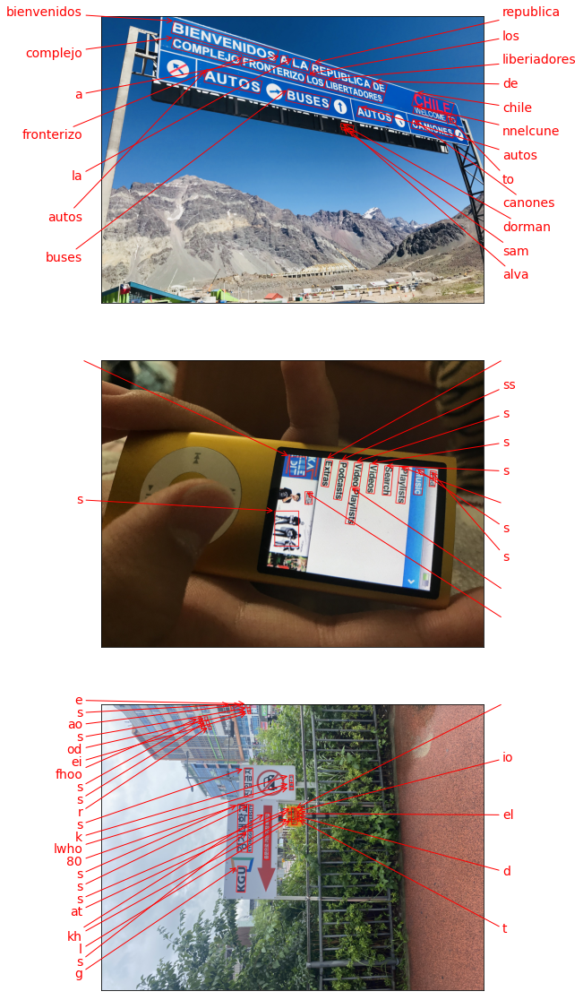

In [9]:
# Plot the predictions
fig, axs = plt.subplots(nrows=len(images), figsize=(20, 20))
for idx, ax in enumerate(axs):
    keras_ocr.tools.drawAnnotations(image=images[idx], 
                                    predictions=prediction_groups[idx][0], ax=ax)

### Tesseract

In [79]:
import os
import pytesseract
from PIL import Image
from pytesseract import Output
import matplotlib.pyplot as plt

# OCR Engine modes(–oem):
# 0 - Legacy engine only.
# 1 - Neural nets LSTM engine only.
# 2 - Legacy + LSTM engines.
# 3 - Default, based on what is available.

# Page segmentation modes(–psm):
# 0 - Orientation and script detection (OSD) only.
# 1 - Automatic page segmentation with OSD.
# 2 - Automatic page segmentation, but no OSD, or OCR.
# 3 - Fully automatic page segmentation, but no OSD. (Default)
# 4 - Assume a single column of text of variable sizes.
# 5 - Assume a single uniform block of vertically aligned text.
# 6 - Assume a single uniform block of text.
# 7 - Treat the image as a single text line.
# 8 - Treat the image as a single word.
# 9 - Treat the image as a single word in a circle.
# 10 - Treat the image as a single character.
# 11 - Sparse text. Find as much text as possible in no particular order.
# 12 - Sparse text with OSD.
# 13 - Raw line. Treat the image as a single text line, bypassing hacks that are Tesseract-specific.

def crop_word_regions(image_path='./images/sample.png', output_path='./output'):
    if not os.path.exists(output_path):
        os.mkdir(output_path)
    custom_oem_psm_config = r'--oem 3 --psm 3'
    image = Image.open(image_path)

    recognized_data = pytesseract.image_to_data(
        image, lang='eng',    # 한국어라면 lang='kor'
        config=custom_oem_psm_config,
        output_type=Output.DICT
    )
    
    top_level = max(recognized_data['level'])
    index = 0
    cropped_image_path_list = []
    for i in range(len(recognized_data['level'])):
        level = recognized_data['level'][i]
    
        if level == top_level:
            left = recognized_data['left'][i]
            top = recognized_data['top'][i]
            width = recognized_data['width'][i]
            height = recognized_data['height'][i]
            
            output_img_path = os.path.join(output_path, f"{str(index).zfill(4)}.png")
            print(output_img_path)
            cropped_image = image.crop((
                left,
                top,
                left+width,
                top+height
            ))
            cropped_image.save(output_img_path)
            cropped_image_path_list.append(output_img_path)
            index += 1
    return cropped_image_path_list


#img_file_path = work_dir + '/test_image.JPG'   #테스트용 이미지 경로입니다. 본인이 선택한 파일명으로 바꿔주세요. 



In [25]:
!sudo apt install tesseract-ocr-kor

Reading package lists... Done
Building dependency tree       
Reading state information... Done
tesseract-ocr-kor is already the newest version (1:4.00~git30-7274cfa-1).
The following packages were automatically installed and are no longer required:
  accountsservice-ubuntu-schemas bc bluez-obexd cups cups-browsed cups-client
  cups-common cups-core-drivers cups-daemon cups-filters
  cups-filters-core-drivers cups-ipp-utils cups-ppdc cups-server-common
  fonts-droid-fallback fonts-noto-mono fonts-urw-base35 ghostscript
  gir1.2-dbusmenu-glib-0.4 gnome-bluetooth gnome-power-manager
  gnome-screensaver gsettings-ubuntu-schemas gvfs-backends indicator-applet
  indicator-application indicator-appmenu indicator-bluetooth indicator-common
  indicator-datetime indicator-keyboard indicator-messages indicator-power
  indicator-printers indicator-session indicator-sound jayatana
  libaccounts-glib0 libbamf3-2 libcdio-cdda2 libcdio-paranoia2 libcdio18
  libcupsfilters1 libfcitx-config4 libfcitx-g

In [93]:
def recognize_images(cropped_image_path_list):
    custom_oem_psm_config = r'--oem 3 --psm 7'
    
    for image_path in cropped_image_path_list:
        image = Image.open(image_path)
        recognized_data = pytesseract.image_to_string(
            image, lang='eng',    # 한국어라면 lang='kor'
            config=custom_oem_psm_config,
            output_type=Output.DICT
        )
        print(recognized_data['text'])
    print("Done")


In [94]:
work_dir = os.getenv('HOME')+'/aiffel/ocr_python'
img_file_path = work_dir + '/testset/12.jpg' 

cropped_image_path_list = crop_word_regions(img_file_path, work_dir)
# 위에서 준비한 문자 영역 파일들을 인식하여 얻어진 텍스트를 출력합니다.
recognize_images(cropped_image_path_list)



/aiffel/aiffel/ocr_python/0000.png
 

Done


### Google OCR API

In [96]:
def detect_text(path):
    """Detects text in the file."""
    from google.cloud import vision
    import io
    client = vision.ImageAnnotatorClient()

    with io.open(path, 'rb') as image_file:
        content = image_file.read()
        
    image = vision.Image(content=content)

    response = client.text_detection(image=image)
    texts = response.text_annotations
    print('Texts:')

    for text in texts:
       print('\n"{}"'.format(text.description))

    vertices = (['({},{})'.format(vertex.x, vertex.y)
                 for vertex in text.bounding_poly.vertices])

    print('bounds: {}'.format(','.join(vertices)))

    if response.error.message:
        raise Exception(
            '{}\nFor more info on error messages, check: '
            'https://cloud.google.com/apis/design/errors'.format(
                response.error.message))

In [109]:
# 로컬 환경에서는 다운받은 인증키 경로가 정확하게 지정되어 있어야 합니다. 
# 클라우드 환경에서는 무시해도 좋습니다
!ls -l $GOOGLE_APPLICATION_CREDENTIALS

import os
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] =  os.getenv('HOME')+'/aiffel/ocr_python/my_google_api_key.json'

# 입력 이미지 경로를 지정해 주세요.
path = os.getenv('HOME')+'/aiffel/ocr_python/testset/13.jpg'


# 위에서 정의한 OCR API 이용 함수를 호출해 봅시다.
detect_text(path)

E0914 15:31:46.998317379     457 fork_posix.cc:70]           Fork support is only compatible with the epoll1 and poll polling strategies


-rw-r--r-- 1 root root 2337 Sep  7 03:24 /aiffel/aiffel/ocr_python/my_google_api_key.json
Texts:

"KGU
O
경기대학교
KYONGGI UNIVERSITY
중문으로 가는 가장 빠른길
주˚의
도시가스배관
연락처 080-215-3002
(주)삼천리
RIGHAZAI
|진입금지
HOME
영통구청
50
HEOBY
(주)한&l
에비후 제일내과의급
8666-61081/9E/E
한남대해서
209
나무로시스
부동산
약
2
CREE
A lo
1) 광교 탑치
496
21
왕십리 조개척
ARGO
| 광교
키조개
가리비"

"KGU"

"O"

"경기"

"대학교"

"KYONGGI"

"UNIVERSITY"

"중문"

"으로"

"가는"

"가장"

"빠른"

"길"

"주"

"˚"

"의"

"도시"

"가스"

"배관"

"연락처"

"080-215-3002"

"("

"주"

")"

"삼천리"

"RIGHAZAI"

"|"

"진입"

"금지"

"HOME"

"영통구"

"청"

"50"

"HEOBY"

"("

"주"

")"

"한"

"&"

"l"

"에비"

"후"

"제일"

"내과의"

"급"

"8666-61081"

"/"

"9E"

"/"

"E"

"한남대"

"해서"

"209"

"나무"

"로시스"

"부동산"

"약"

"2"

"CREE"

"A"

"lo"

"1"

")"

"광교"

"탑치"

"496"

"21"

"왕십리"

"조"

"개척"

"ARGO"

"|"

"광교"

"키조개"

"가리비"
bounds: (1615,48),(1608,3),(1625,1),(1632,46)


## **Step3. 테스트 결과 정리**
모듈들마다 출력 형태가 다릅니다. 분석을 위해 결과를 일목요연하게 정리해 보는 것이 도움이 될 것입니다. 시각화 방법이 함께 활용된다면 더욱 좋겠군요.



> ### 그늘에 일부가 가려진 살짝 기울어진 문자들

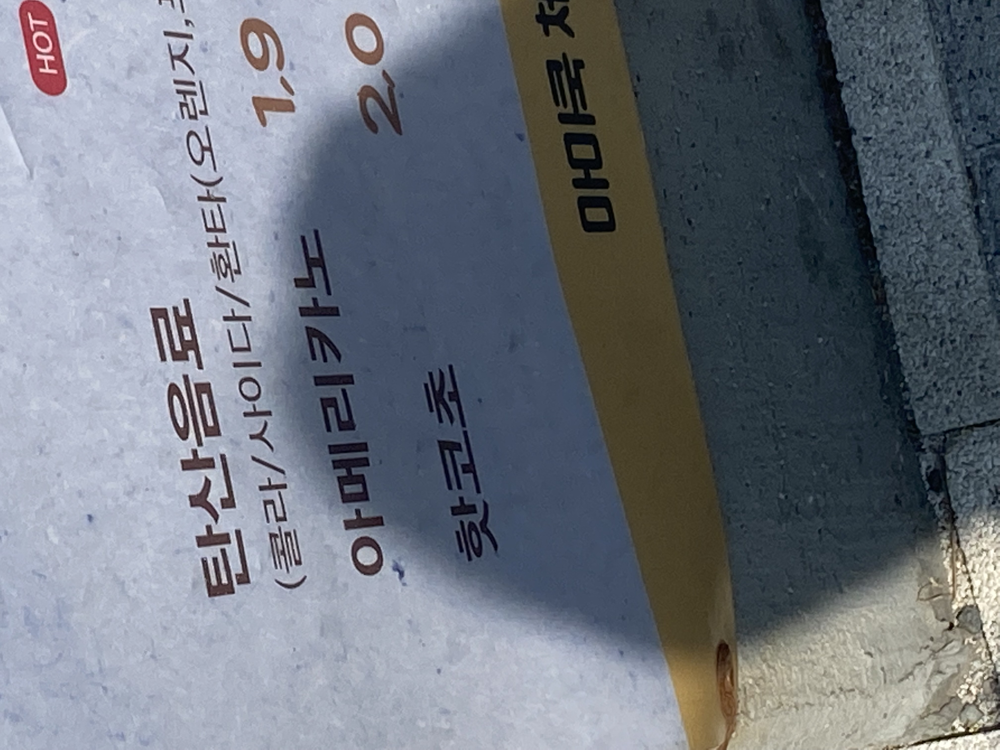

### keras-ocr

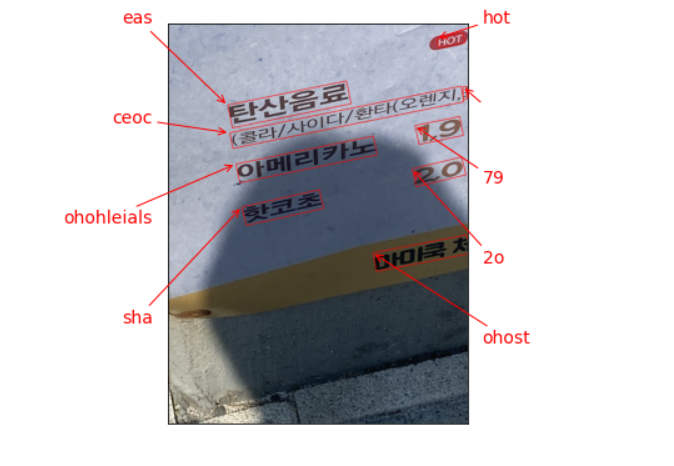

👉 한국어로 train 되지 않은 모델이라 detection은 정상적으로 되나 결과가 적절하지 못하게 나옴.  
hot과 2.0은 얼추 비슷하게 인식해낸 것을 볼 수 있다.

### google

Texts:

"놀메
20
6'L
핫코초
LOH
모리모
(콜라/사이다/환타(오렌지,
탄산음료"


👉 살짝 그늘진 사진이라 '아메리카노'를 제대로 인식하지 못했다. '놀메' 가 '아메리카노'를 인식하고자 한 노력으로 보인다.  
반만 그늘진 사진이라서 그런가? 아예 그늘진 '핫코초'는 또 잘 인식했다.

---

> ### 살짝 기울어졌지만 조도 일정한 상황에서 비교적 식별하기 쉬운 문자들

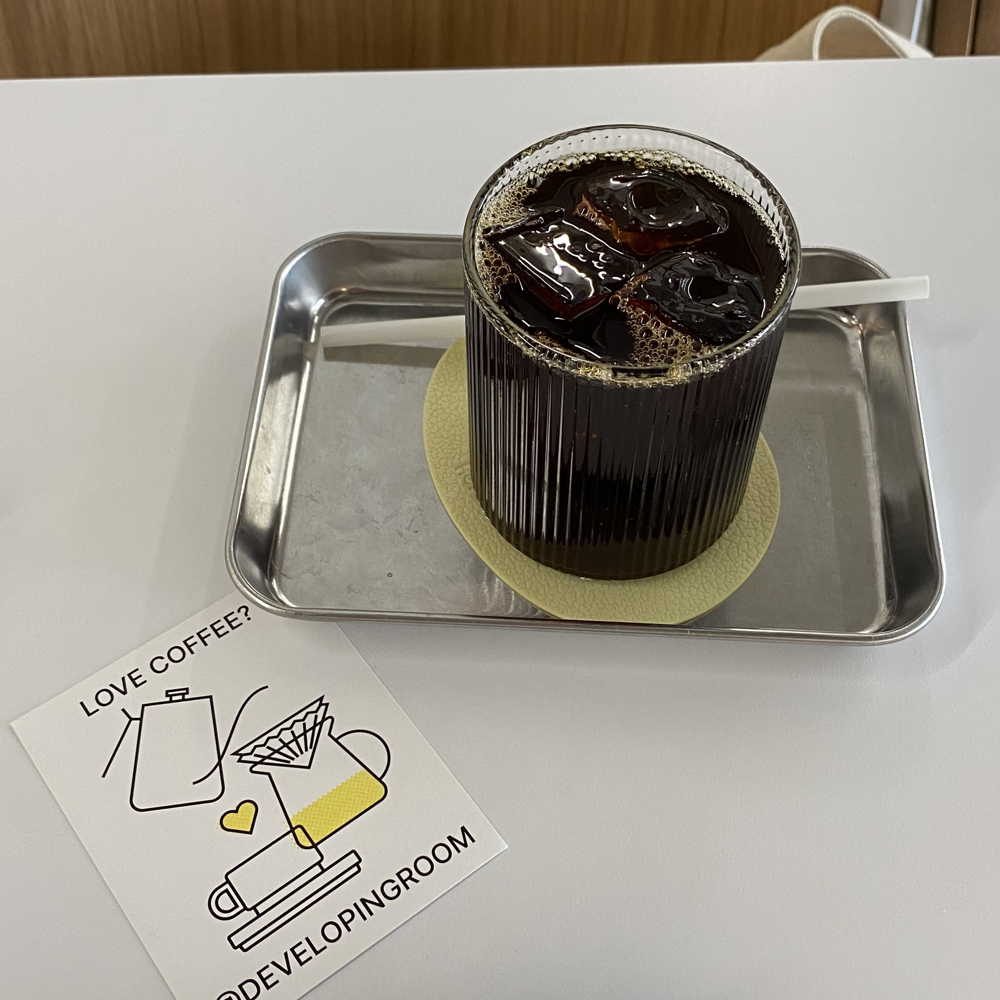

### keras-ocr

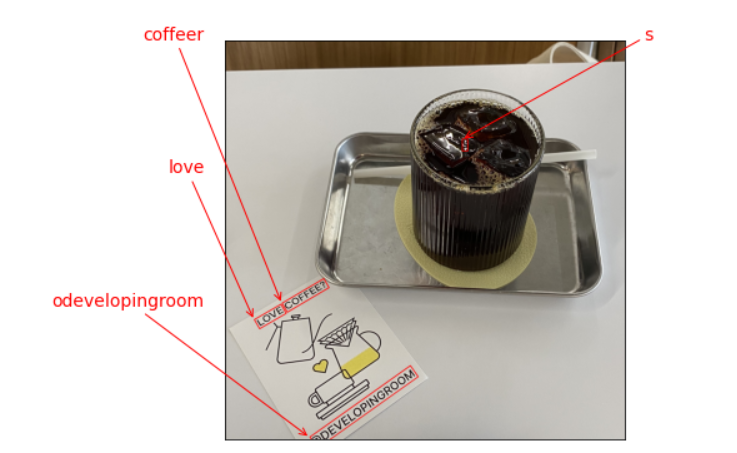

👉 물음표를 'r'로 인식한 것과 @를 'o'로 인식한 것 외에는 정확했다. 물론 뜬금없는 얼음에 's'를 인식해낸건 의문이지만..  
비교적 깔끔한 문자의 사진은 식별률이 높아보인다.

### google

Texts:

"LOVE COFFEE?
CX
DEVELOPINGROOM"


👉 완벽하다. 사진에서 살짝 잘린 @를 CX라고 인식한 것만 빼면 ㅎㅎ 아니면 그림을 CX라고 인식했을 수도 있다.

> ### 멀리 떨어져있는 문자들

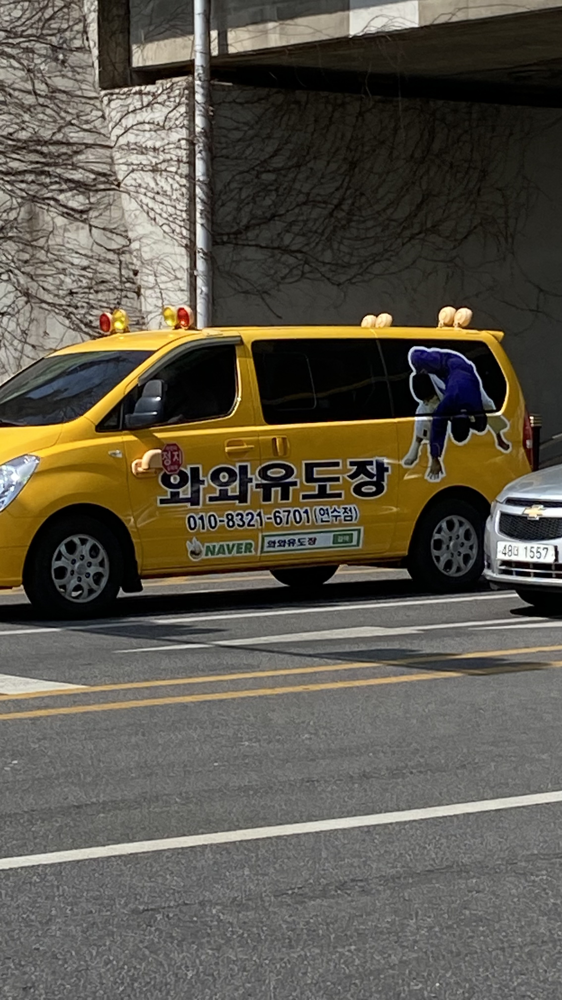

### keras-ocr

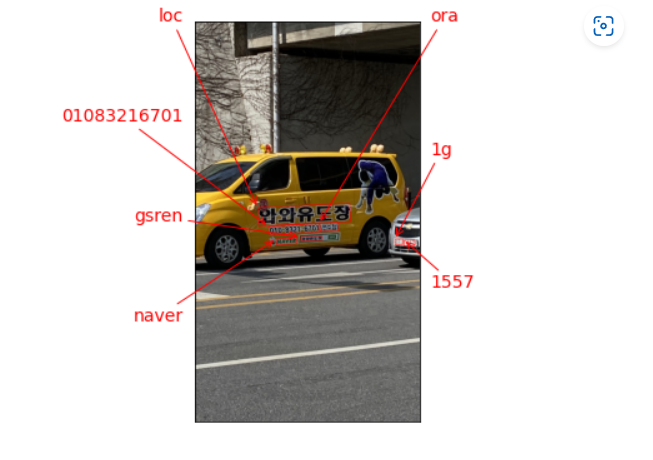

👉 한글이 아닌 부분은 역시 잘 인식했다. 멀리있어서 화질이 떨어지지만 잘 인식함.

### google

Texts:

"정지
와와유도장
010-8321-6701 (연수점)
NAVER 와와유도장
CL
480 1557"


👉 한글 잘 인식하고, 전화번호도 하이픈 포함 잘 인식했다.

> ### 한글 광고판 + 손글씨 문자

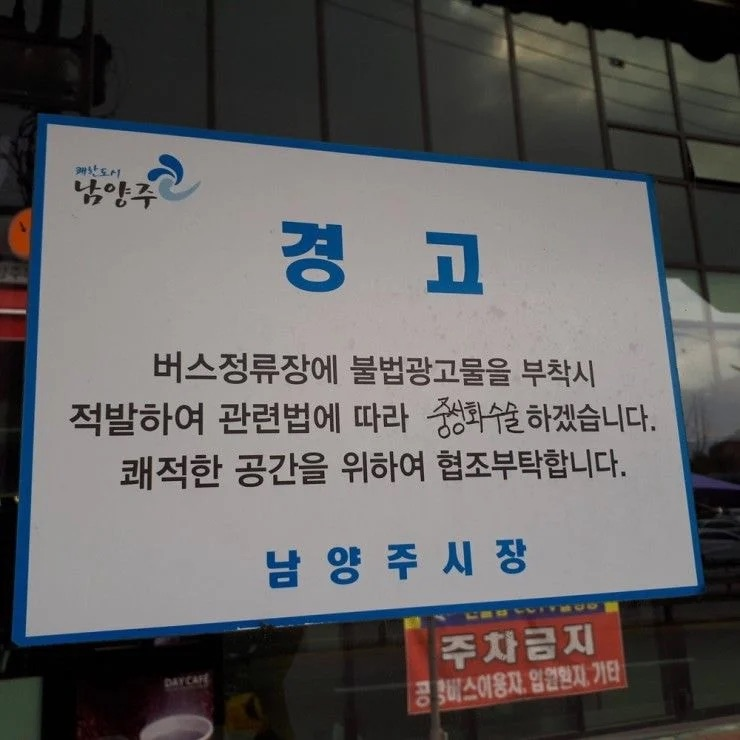

### keras-ocr

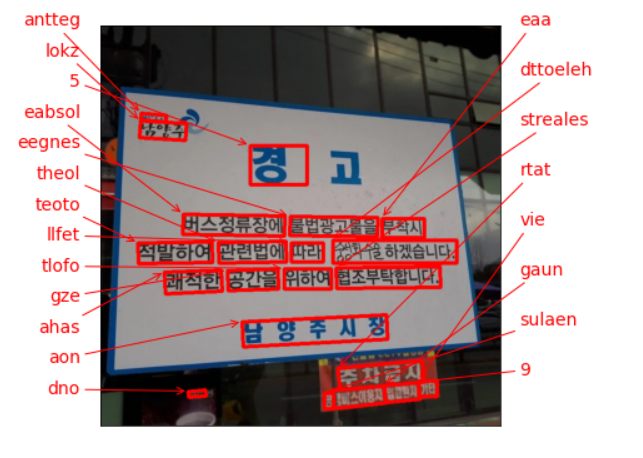

👉 역시 detection은 잘 했네요.

### google

Texts:

"쾌한도시
남양주
경고
버스정류장에 불법광고물을 부착시
적발하여 관련법에 따라 중성화수술하겠습니다.
쾌적한 공간을 위하여 협조부탁합니다.
남양주시장
DAY CAFE
주차금지
공 비스이용자, 입원환자, 기타"


👉 '중성화수술'이라는 손글씨도 잘 인식했고 정말정말 작게 보이는 'Day cafe' 문자도 잘 인식했습니다. wow '공항버스이용자'는 '공 비스 이용자'로 잘못 인식했네요.

> ### 다양한 폰트, 크기, 한영 혼용, 손글씨 문자 인식

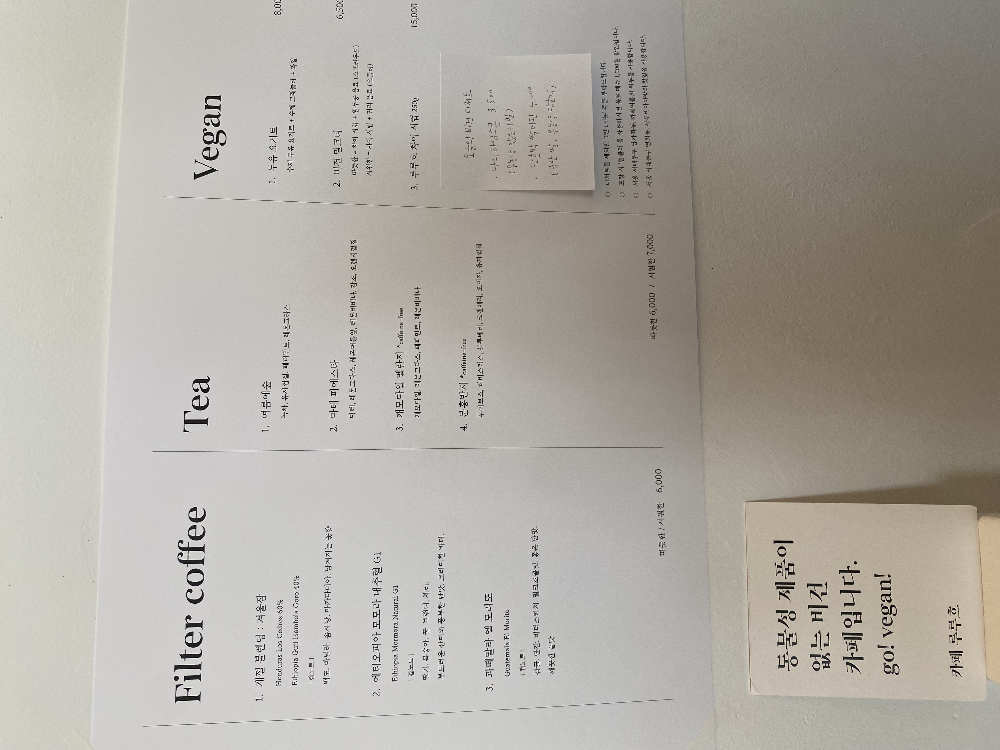

### keras-ocr

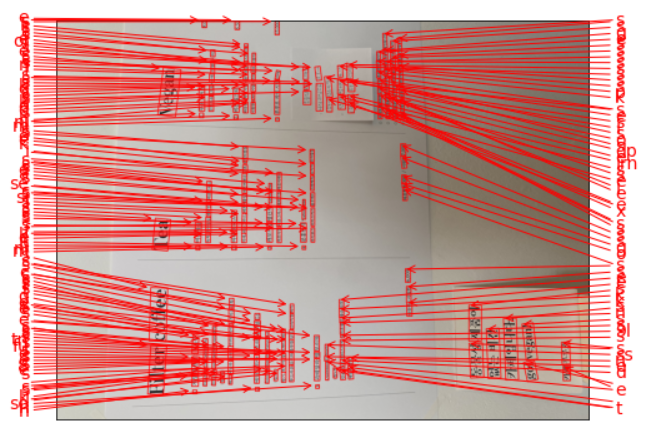

👉 문자가 너무 많은 경우에는 keras-ocr이 적합하지 않아 보인다. 식별할 수가 없다. 게다가 어째선지 사진이 회전되어서 더 인식할 수가 없다.

### google

Texts:

"Filter coffee
1. 계절 블렌딩 : 겨울잠
Honduras Los Cedros 60%
Ethiopia Guji Hambela Goro 40%
| 컵노트 |
백도. 바닐라. 솜사탕. 마카다미아. 남겨지는 꽃향.
2. 에티오피아 모모라 내추럴 G1
Ethiopia Mormora Natural G1
| 컵노트 |
딸기. 복숭아. 꿀. 브랜디. 체리.
부드러운 산미와 풍부한 단맛. 크리미한 바디.
3. 과떼말라 엘 모리또
Guatemala El Morito
| 컵노트 |
감귤. 단감. 버터스카치. 밀크초콜릿. 좋은 단맛.
깨끗한 끝맛.
따듯한 / 시원한 6,000
동물성 제품이
없는 비건
카페입니다.
go! vegan!
카페 루루흐
Tea
1. 여름에숲
녹차, 유자껍질, 페퍼민트, 레몬그라스
2. 마테 피에스타
마테, 레몬그라스, 레몬머틀잎, 레몬버베나, 감초, 오렌지껍질
3. 캐모마일 멜란지 *caffeine-free
캐모마일, 레몬그라스, 페퍼민트, 레몬버베나
4. 분홍반지 *caffeine-free
루이보스, 히비스커스, 블루베리, 크랜베리, 오미자, 유자껍질
따듯한 6,000 / 시원한 7,000
Vegan
1. 두유 요거트
수제 두유 요거트 +수제 그래놀라+ 과일
2. 비건 밀크티
따듯한 = 차이 시럽 +완두콩 음료 (스프라우드)
시원한 = 차이 시럽 +귀리음료 (오틀리)
3. 루루흐 차이 시럽 250g
오늘의 비건 디저트
• 나의 라임스콘 3,500
(무농약 앉은키밀)
단호박 쌀머핀 4,000
(국산 쌀, 무농약 단호박)
8,00
○ 디저트를 제외한 '1인 1메뉴' 주문 부탁드립니다.
○ 포장 시 '텀블러'를 사용하시면 음료 메뉴 1,000원 할인됩니다.
○ 서울 서대문구 남가좌동, 까페여름의 원두를 사용합니다.
○ 서울 서대문구 연희동, 사루비아다방의 찻잎을 사용합니다.
6,50C
15,000"


👉 정확하게 모든 문자가 인식되었다. 문자가 많음에도 불구하고 시간도 적게 소요되었다.

> ### 정자 영문 메뉴판 

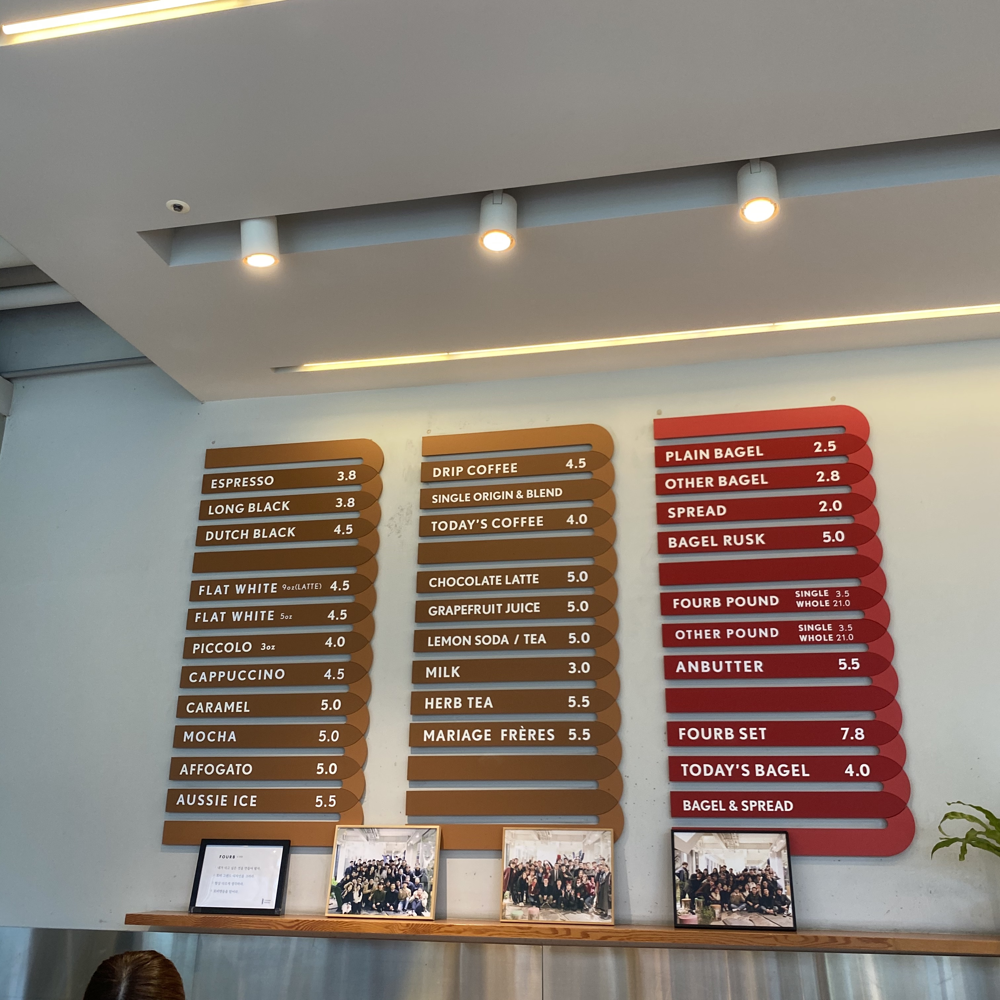

### keras-ocr

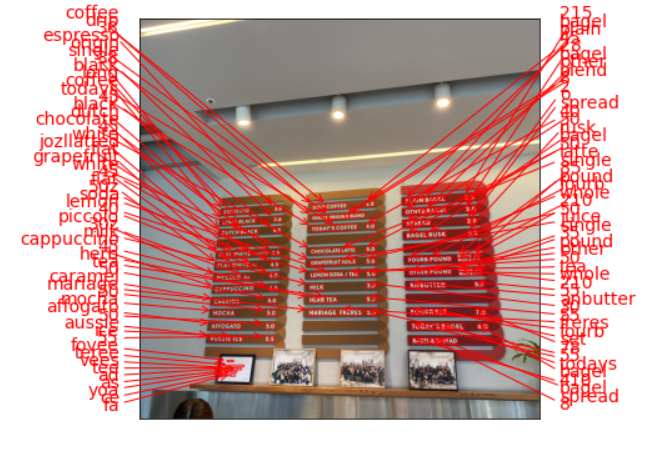

👉 이 사진도 문자가 너무 많긴 한데 중간중간에 보이는 커피 메뉴가 잘 인식되었음을 보여준다.

### Tesseract

" ESPRESSO

Yale

a a an


ae

ATTE

Bay;

COLO 3ez

| CARAMEL

5.0

5 0

Niel

VI -

ICE
 

PLAIN BAGEL

DRIP

COFFEE

aN)

BAGEL

SINGLE C

2IGIN

yee

OTHE

PX) 38

2.8

4 a

BAGEL

10h

a
TODAY'S COFFEE

| s

g
| CHOCOLATE

SINGLE

POUND § wuote ae

Pat < ) od ee

Pars

; 4%

'

Bah RP EEN el

1! EMON SODA / TEA

MILK

ey dee

AWN

UTTER

WINN 3

3-4) a5

EOURB

ra.

AUSSIE ICE

ISSIE ICE 2) BAGEL & SPREAD


👉 드디어 옳게 인식된 태서랙트 결과물이다. 완벽하다고는 결코 말할 수 없지만... 큼직큼직한 메뉴명들이 잘 인식되었음을 알 수 있다. 

### google

Texts:

"ESPRESSO
LONG BLACK
DUTCH BLACK
PICCOLO 3oz
CAPPUCCINO
FLAT WHITE 9oz(LATTE) 4.5
FLAT WHITE 5oz
4.5
4.0
CARAMEL
MOCHA
AFFOGATO
AUSSIE ICE
FOURB**
내가 사고 싶은 것을 만들어 팔자.
● 토비 그랜드 디자인을 그려
항상 다르게 생각하라.
팬들을 믿어라.
3.8
3.8
4.5
4.5
5.0
5.0
5.0
5.5
DRIP COFFEE
SINGLE ORIGIN & BLEND
TODAY'S COFFEE
CHOCOLATE LATTE
GRAPEFRUIT JUICE
LEMON SODA / TEA
MILK
HERB TEA
4.5
4.0
5.0
5.0
5.0
3.0
5.5
MARIAGE FRÈRES 5.5
PLAIN BAGEL
OTHER BAGEL
SPREAD
BAGEL RUSK
FOURB POUND
OTHER POUND
ANBUTTER
FOURB SET
BAGEL & SPREAD
2.5
TODAY'S BAGEL
2.8
2.0
5.0
SINGLE 3.5
WHOLE 21.0
SINGLE 3.5
WHOLE 21.0
5.5
7.8
4.0"


👉 정말 정확한 인식. 여기서 놀란 점은 밑에 놓인 사진 액자들 속 아주 조그만 글자들 ' 내가 사고 싶은 것을 만들어 팔자 ' 같은 문자들도 정확히 인식했다는 점이다. 

> ### 사선으로 배열된 문자들

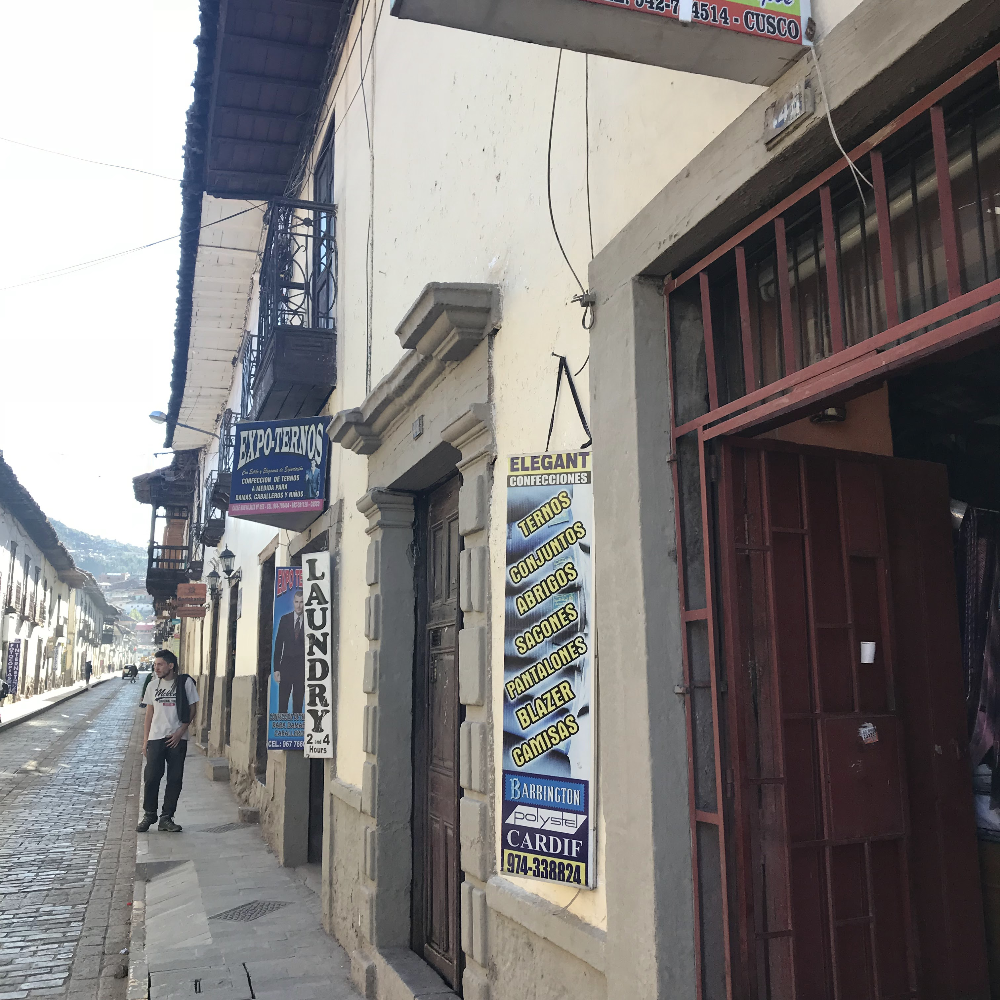

### keras-ocr

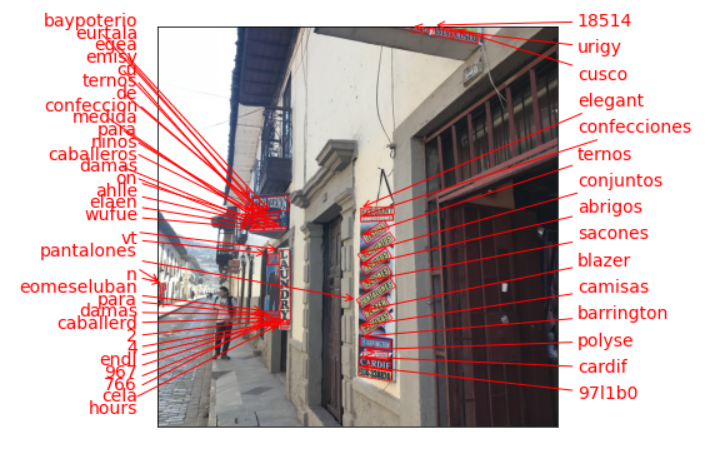

👉 LAUNDRY 같은 세로로 적힌 문자는 인식할 수 없다. 'Expo-ternos'와 같은 변형이 심한 폰트는 인식하기 어려워한다. 약간 사선으로 배열된 문자는 인식 가능! 

### google

Texts:

"Tibe
Mcken
ORIGINAL SON
EXPO-TERNOS
Con Estilo y Elegancia de Exportación
CONFECCION DE TERNOS
A MEDIDA PARA
DAMAS, CABALLEROS Y NIÑOS
CALLE NUEVA ALTA P 452-CEL 964-790404-983-381128-CUSCO
CONFECCION DE TE
PARA DAMAS
LAUNDR
Y
CABALLERO 2 and
4
CEL.: 967 7660
Hours
ELEGANT
CONFECCIONES
TERNOS
CONJUNTOS
ABRIGOS
SACONES
Le
PANTALONES
BLAZER
CAMISAS
BARRINGTON
polystel
CARDIF
974-338824
4514-CUSCO
232330"


👉 LAUNDRY 잘 인식되었고 살짝 잘린 숫자를 keras-ocr이 인식하지 못했는데 google은 잘 인식했다. Expo-ternos도 역시 잘 인식.

> ### 스페인어 간판 고딕이 아닌 폰트 인식

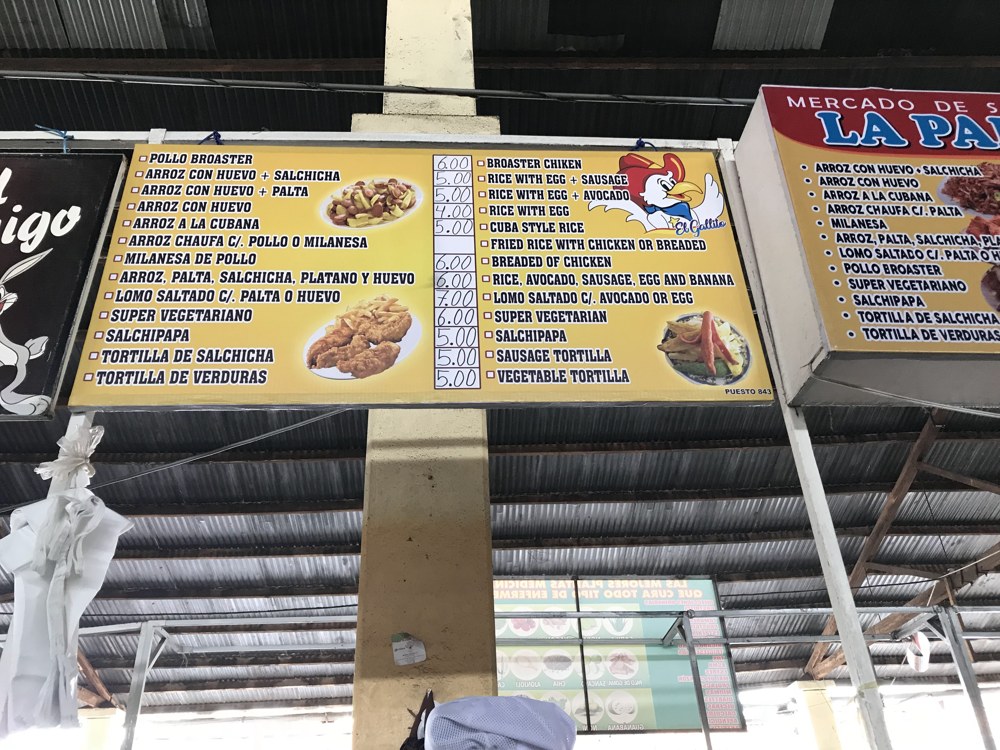

### keras-ocr

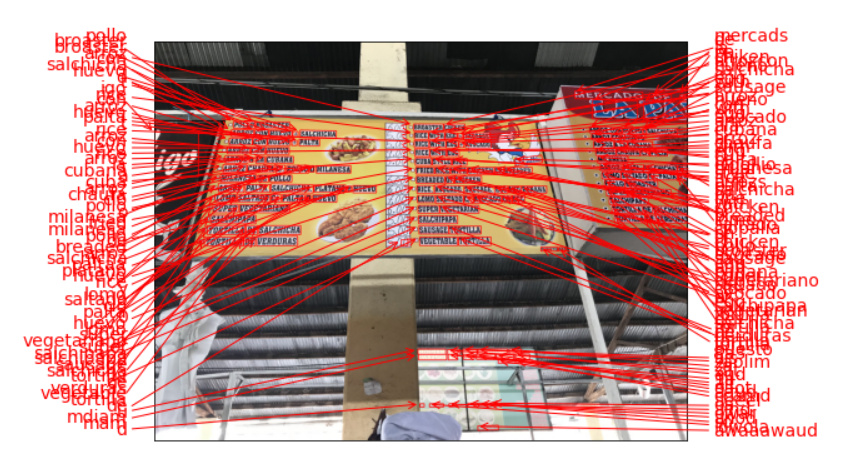

👉 이것도 문자가 너무 많다.. 나의 실수 .. 군데군데 보이는 단어로는 잘 인식이 된 것 같기도 한데.. 못쓰겠다.

### Tesseract

v SBNNUG GiAUurl G/. FULLY U MILANGEOA OFRIED RIGE WITH CHICKEN OR BREADED :
JZ thee DE POLLO O BREADED OF CHICKEN \\
‘Mm OFARPBNTZ DAITA CAIPUIrUA DI_ATAND V UNEUN T\/)\ ODICE AINFANN CANTCACE Te ALIN DAYAR \

\

 

 

 

   


¥








AAW & SW TIVE & Sl

BRP FEEL & EE Be Ee


~e WRAL

OFA CH PRAT






)

| 2 Cc, OUUBA oLYTLE RILE eet OS \ \

 


JARROZ

 AaRRrrary

CON



SALCHICHA


RICE

~~ RIA

WITH

EGG




CARROZ CON HUEVO + PALTA












GUN HUEY
CON HUEV(


ARROZ





 

ARROZ


LA

CUBANA



PAITA.






SALTADO CI RATES

Cl

RPALTA OS


) OF



yA f OMILANESA DE POLLO  _ 6.00

—~APRPRPAT RAIMA @AT RITTRITA FY AMAR WU Teer ——————






NEGETARIANG



 

&

| oaaememminniaeie diame tmmsiemnemetananmeteenen A
Se enn Gatmmmen pam RAIMA A UWIIrin —

ie VU |



 





PALTA,

SALCHICHA,

Fay, Fearn n ch

PLATANO



AVOCADO.

SAUSAGE,

EGG

AND





SALTAD


PALTA 0 HUEVO

0

HUEVO

 

1LOMO
1CHDE

SALTADC
2 Veer

Ci.
DIR

 


\ EGG






 



2 SS |
ae a ee ee


15 UPER

VEGETARIANO




VORTILLA DE SALCMICIAR

DE

SALCMICIAR


VEGETARIANO











I SALCHIPAPE






TORTIE


NERD






O SAUSAGE

TORTILLA





I TORTILLA DE VERDURAS


VERDURAS



 

ct

 

    
   

Pr ci

1h a
il

t

TOLLE EREOT nna A ,

__| __ Ta
Pema

= LL
A ay ib be vii | be ¥ — : \ _————— : AL — sae ar Nila —— zi Fi

~~ —

mee aa

 

              
   
   
 
 

 


CPP EP EP PEED EE

SS

TTY



Qa ws


👉 이것저것 인식이 되었는데 썩 괜찮다. 문자 아닌데 문자로 왜 쓸데없이 인식되는걸까? 문자인지 아닌지의 detection이 별로다. 

### google

Texts:

"igo
OPOLLO BROASTER
ARROZ CON HUEVO + SALCHICHA
DARROZ CON HUEVO + PALTA
DARROZ CON HUEVO
DARROZ A LA CUBANA
ARROZ CHAUFA C/. POLLO O MILANESA
OMILANESA DE POLLO
ARROZ, PALTA, SALCHICHA, PLATANO Y HUEVO
OLOMO SALTADO C/. PALTA O HUEVO
□SUPER VEGETARIANO
□SALCHIPAPA
TORTILLA DE SALCHICHA
TORTILLA DE VERDURAS
ka Colore
6.00 BROASTER CHIKEN
5.00 ORICE WITH EGG + SAUSAGE
5.00 ORICE WITH EGG + AVOCADO
4.00 ORICE WITH EGG
CUBA STYLE RICE
5.00
El Gallito
OFRIED RICE WITH CHICKEN OR BREADED
BREADED OF CHICKEN
RICE, AVOCADO, SAUSAGE, EGG AND BANANA
LOMO SALTADO C/. AVOCADO OR EGG
6.00
6.00
7.00
6.00 SUPER VEGETARIAN
5.00 SALCHIPAPA
5.00 SAUSAGE TORTILLA
5.00 VEGETABLE TORTILLA
иразм ГАТГАЈЧ 23ЯМ ГА
ІМЯ НИЗ 30 11 IT OQOT ASUS BUO
AD JOLNOLA AIHD CADMA2 AM 30 JAN
IN
AWASANAUÐ
CAIRAMIRU DORMI
2ITIATZAR
CHROMUT
STATCORA
MATE
PUESTO 843
UP
200 DAT
201
AMZA
2323
MOSA 930 JAM
20AJORA
CAMOIM
CIT8A10
CAROU
COTURIAS
OHTLETEA
MERCADO DE
S
LA PA
O ARROZ CON HUEVO SALCHICHA
O ARROZ CON HUEVO
ARROZ A LA CUBANA
ARROZ CHAUFA C/.PALTA
O MILANESA
O ARROZ, PALTA, SALCHICHA, PLA
LOMO SALTADO C/.PALTAO H
O POLLO BROASTER
O SUPER VEGETARIANO
O SALCHIPAPA
O TORTILLA DE SALCHICHA
O TORTILLA DE VERDURAS"

👉 잘 됐지만 중간에 키릴문자로 잘못 인식을 한 부분도 있다. 

> ### 다양한 크기와 폰트의 스페인어 인식

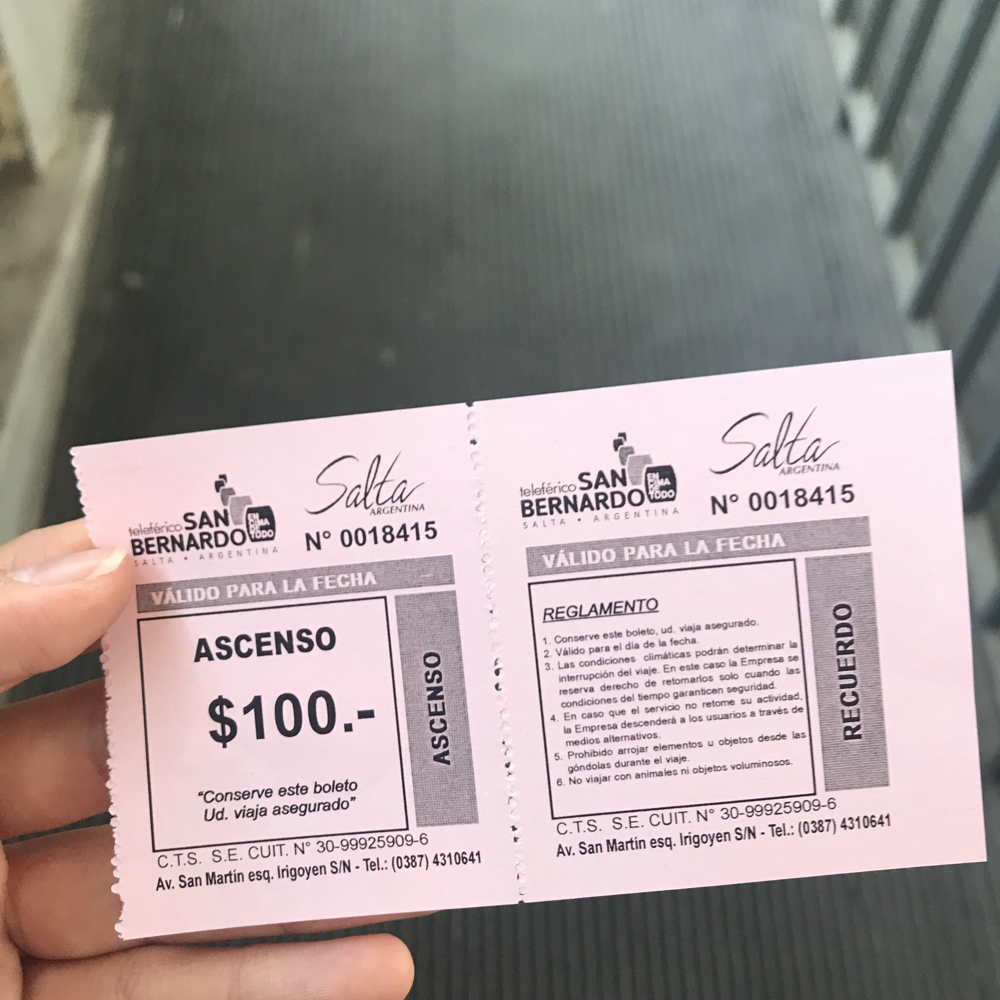

### Tesseract

AN.


earert SAN & | °
sERNRRDOE

“Conserve




f
ARGENTINA


0018415


viaja

asegurado”

CTS.








lrigoyer




(0387)


 

20-99925909-6




interrupcion

 



 

reserva


 





garanucen





 

cervical





 

Ee mpre

descendelsa




medios

alternativos




Prohibide

arro}yet






gondolas

durante

 




viaje


animales

 



e
¢. $s
seleterico DAN ‘ Em

BERNARDO

CALTAL* *

4. Conserve este
2. Valido pare e
3. Las condiciones
interrupcion del viaje
echo de retomarios solo
condiciones de! bempo garanucen segundad
so que el servicio NO retore SU actvicac
la Empres@ descendera 4 los usuarios 4 traves Sf
medios alternativos

‘ 5 Prohibido arrojar elementos U obyetos desde las
“Conserve este boleto ; ge

ndolas durante el viaje

Ud. viaja asegurado” F 6. No viajar con animales ni objetos yolurninosos.

CTS: SE. CUIT. N° 30-99925909-6 | CCS. SE. CUIT- N° 30-99
Av. San Martin esq. Irigoyen SIN - Tel.: (0387) 4310641 av. San Martin esq. irigoyen S

 

👉 상당히 부정확하다.

### google

"teleférico SAN
BERNARDO DO
MA
SALTA ARGENTINA
Salta
ARGENTINA
No 0018415
VÁLIDO PARA LA FECHA
ASCENSO
$100.-
"Conserve este boleto
Ud. viaja asegurado"
ASCENSO
C.T.S. S.E. CUIT. N° 30-99925909-6
Av. San Martín esq. Irigoyen S/N - Tel.: (0387) 4310641
teleférico SAN
BERNARDO DO
IMA
SALTA ARGENTINA
Salta
ARGENTINA
N° 0018415
VÁLIDO PARA LA FECHA
REGLAMENTO
1. Conserve este boleto, ud. viaja asegurado.
2. Válido para el día de la fecha.
3.
Las condiciones climáticas podrán determinar la
interrupción del viaje. En este caso la Empresa se
reserva derecho de retomarios solo cuando las
condiciones del tiempo garanticen seguridad.
4. En caso que el servicio no retome su actividad,
la Empresa descenderá a los usuarios a través de
medios alternativos.
5. Prohibido arrojar elementos u objetos desde las
góndolas durante el viaje.
6. No viajar con animales ni objetos voluminosos.
RECUERDO
C.T.S. S.E. CUIT. N° 30-99925909-6
Av. San Martín esq. Irigoyen S/N - Tel.: (0387) 4310641"

👉 매우 정확하다. 깨알같은 이용약관 하며 숫자도 정확하고 .. 

> ### 파란색 배경의 하얀 글씨 인식

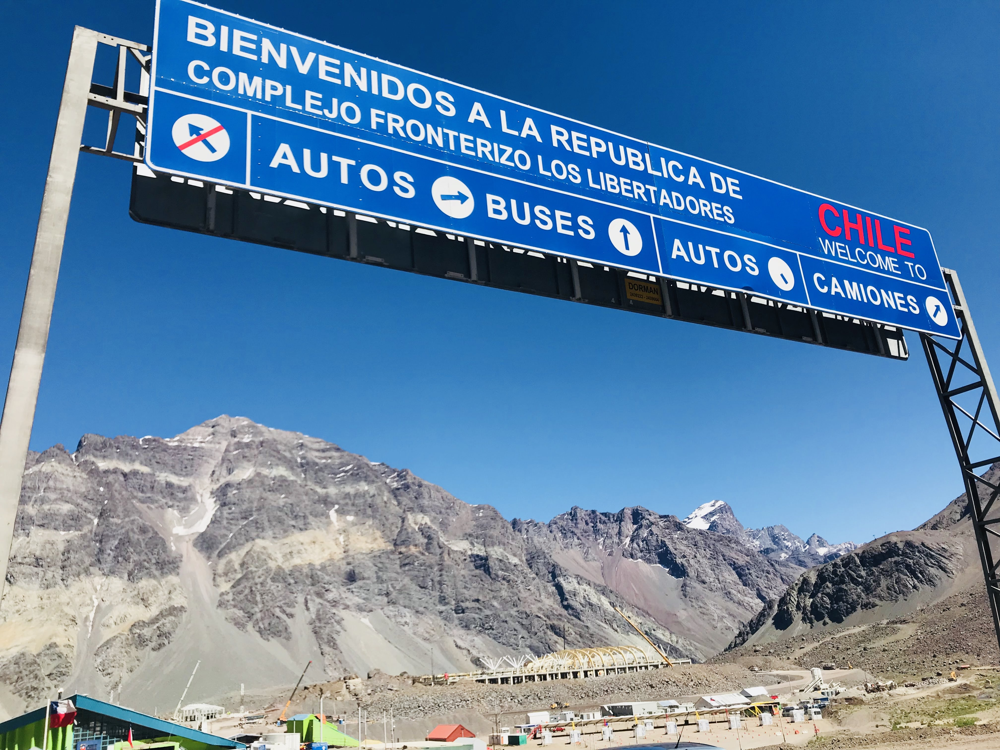

### keras-ocr

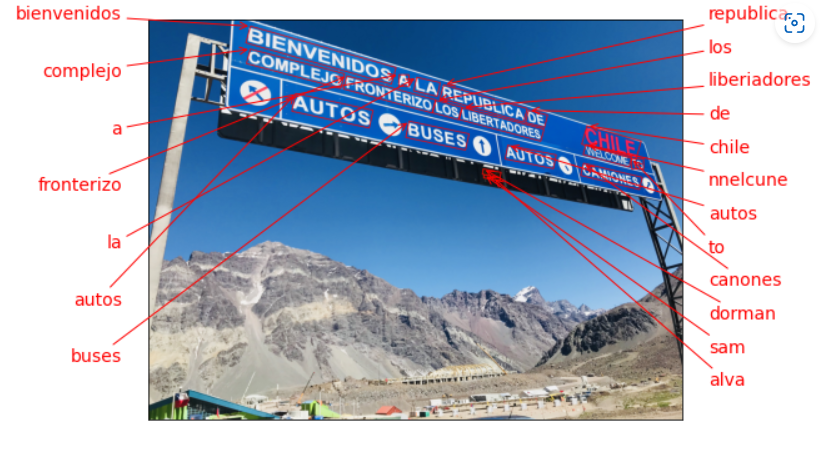

👉 문자가 아닌 부분을 인식한 경우도 있었으나 매우 높은 정확도를 보인다. 

### google

"F
BIENVENIDOS A LA REPUBLICA DE
COMPLEJO FRONTERIZO LOS LIBERTADORES
AUTOS BUSES
DORMAN
2439222-243966A
A
CHILE
WELCOME TO
AUTOS CAMIONES"

👉 표지판 밑에 그늘진 부분에 dorman 어쩌고 적힌 숫자도 비슷하게 인식했다. 미쳤다.

> ### 회전한 사진의 문자 인식

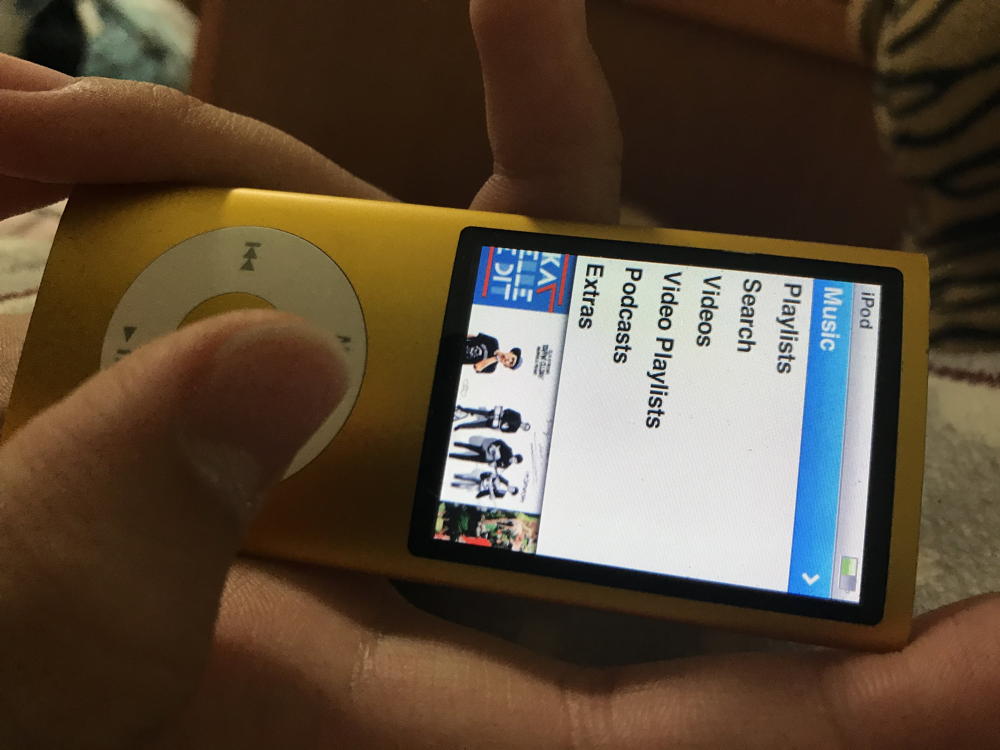

### keras-ocr

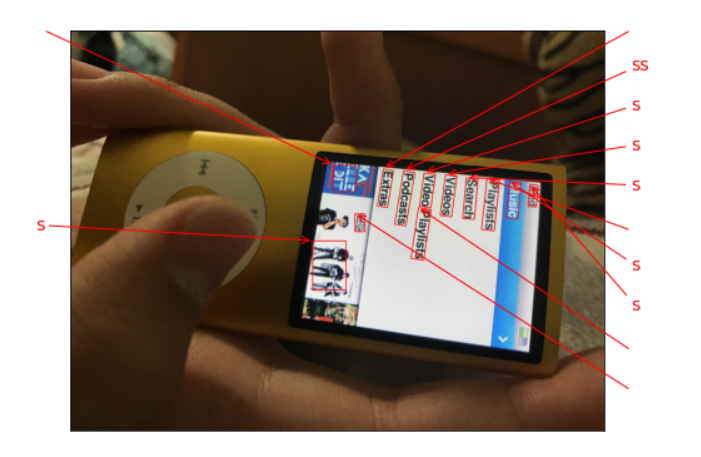

👉 회전한 사진은 전혀 인식하지 못한다. detection은 가능.

### google

"iPod
Music
Playlists
Search
Videos
Video Playlists
Podcasts
Extras
KA
DIT
3
RAS"

👉 회전된 사진도 정확하다! 앨범아트에 적힌 글씨도 조금만 더 선명했다면 인식했을 수도 있을듯..;

> ### 여러가지 크고 작은 간판 인식

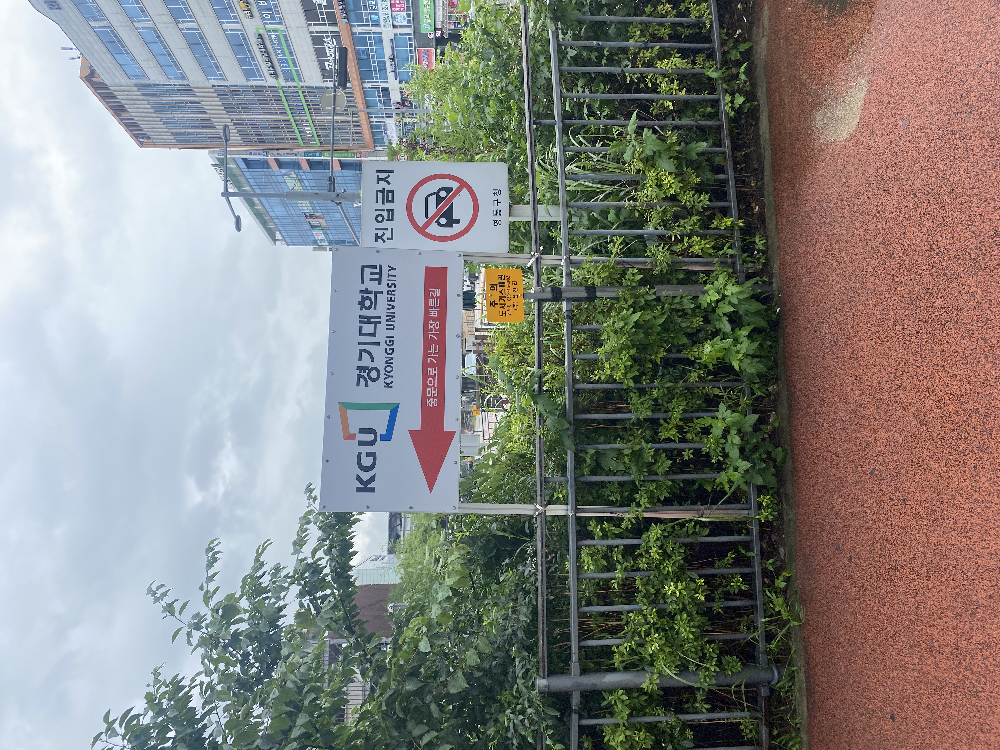

### keras-ocr

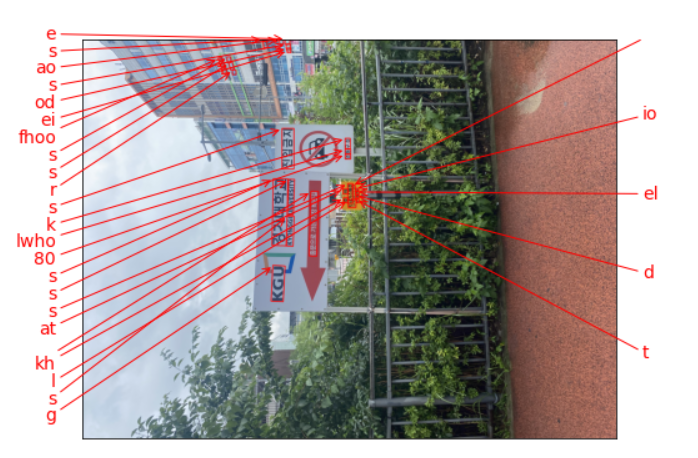

👉 왜때문에 사진이 돌아갔는지 모르겠다.ㅠ

### google

Texts:

"KGU
O
경기대학교
KYONGGI UNIVERSITY
중문으로 가는 가장 빠른길
주˚의
도시가스배관
연락처 080-215-3002
(주)삼천리
RIGHAZAI
|진입금지
HOME
영통구청
50
HEOBY
(주)한&l
에비후 제일내과의급
8666-61081/9E/E
한남대해서
209
나무로시스
부동산
약
2
CREE
A lo
1) 광교 탑치
496
21
왕십리 조개척
ARGO
| 광교
키조개
가리비"


👉 작은 간판 삼천리 어쩌고 이것만 인식하게 하려고 했는데.. 뒤에 보이는 간판 전부 인식했고, 잘 인식되었다.. 따봉

## **Step4. 결과 분석과 결론 제시**
우선 여러분들이 구현하고자 하는 서비스의 목적과 내용을 먼저 정리합니다. 여러분들이 검토한 OCR 모델들이 그 목적에 부합하는지 확인하기 위해 필요한 평가 기준을 제시합니다. 그 기준에 따라 위에서 정리한 테스트 결과를 분석하여 가장 나은 대안의 모델을 선정합니다.

### 구현하고자 하는 서비스 목적 / 내용

* 문자가 들어있는 사진을 찍었을 때 해당 사진에 들어있는 글자를 인식해서 해당 사진을 분류해주는 서비스  
    * 소요시간이 빨랐으면 좋겠어요.
    * 무엇보다도 detection이 잘 되어야 되겠어요.
    * 결과물이 str로 나왔으면 좋겠어요. 바로 쓸수있게
    * 작은 글씨도 인식해줬으면 좋겠어요.

---

### 결과 분석 및 결론

|                  | keras-ocr | Tesseract | google ocr |
|------------------|:---------:|:---------:|:----------:|
| detection        |  Great! 👍 |    BAD    |  Great! 👍  |
| recognition      |    Good   |  Not Bad  |  Great! 👍  |
| rotation         |    BAD    |    BAD    |  Great! 👍  |
| small characters |    Good   |  Not Bad  |  Great! 👍  |
| running time     | slow      | ?         | Fast       |

### keras-ocr

* detection은 좋았으나 살짝 recognition 정확도가 떨어졌다.
* 작은 글씨 인식도 잘하고 그늘진 글씨도 잘 인식했다.
* 회전된 글자들은 인식하지 못했다.
* 너무 느렸다. 그림도 그려야 하고 노고는 알겠다만..
* 그림으로 detection 한 부분을 알려줘서 어떤 글자를 어떻게 인식했는지 알수 있어서 인식 정확도를 알기에 편했다.
* 한글 인식이 안됨.

### Tesseract

* detection 자체가 잘 안됐다. 
* 쓸데없는 인식결과를 많이 뱉었다. 문자가 아닌데 인식했다거나..
* 회전된 글자들은 인식하지 못했다. 22
* 인식 정확도가 떨어진다고 본다.

### google ocr api

* detection, recognition 모두 우수했다.
* 작은 글씨, 그늘진 글씨, 살짝 잘린 글씨 모두 잘 인식했다.
* 부분적으로 그늘진 글씨는 살짝 잘 못했다.
* 회전된 글자들 인식 잘했다.
* 소요시간이 빨라서 좋았다. 
* 유료라는게 단점일까나?

---

### 결론

압도적으로 **google ocr api**가 좋다. 설계하고자 하는 서비스의 needs(소요시간, detection, small characters)를 모두 충족시키고 정확도도 매우 높기 때문!   
그러나 유료이므로 지속적으로 **사용료**가 서비스 이용료 책정에 영향을 미칠 것으로 예상된다.  

차선책으로 **keras-ocr**을 택할수도 있다. needs(소요시간, detection, small characters)를 얼추 충족시키고 무엇보다 **무료** 라는 점? 물론 상업적으로 사용했을 때의 api 사용료는 알아보지 않아서 그 부분은 고려해봐야 할 사항이다. 또한 회전된 사진에서는 인식하기 어렵다는 점과 출력물이 그림으로 나온다는 게 또 다른 고려사항이 될 수 있겠다. 현재 drawannotations tool을 사용하고 있어서 저렇게 출력된 것일수도 있기 때문에 keras-ocr api의 옵션을 잘 사용하면 str값으로 출력할 수 있다고 생각된다. 


## 🎯 루브릭
| **평가문항** | **상세기준** | **성취결과** |
|:---:|---|:---:|
| 1. OCR을 활용하여 구현하려는 서비스의 기획이 타당한가? | 기획한 서비스가 OCR 적용 가능한 서비스이며, OCR 기술을 활용했을 때 더 유용한지에 대한 타당성 여부를 기술하였다. | O |
| 2. 모델 평가기준이 명확하고 체계적으로 세워졌는가? | 앞서 기획한 서비스에서 OCR 모델들이 그 목적에 부합하는지 확인하기 위해 필요한 평가 기준을 제시하고, 평가기준에 적합한 테스트 데이터의 특징이 무엇인지 설명하였다. | O |
| 3. 평가기준에 따라 충분한 분량의 테스트가 진행되고 그 결과가 잘 정리되었는가? | 최대 20장까지의 테스트 이미지를 사용해 제시된 평가 기준에 따른 테스트 결과가 잘 정리되어 결론이 도출되었다. | O |

## ✍ 회고

* keras-ocr 한글 사용할 수 있을 것 같긴한데 코드를 어떻게 수정해야 할 지 모르겠더라..
* keras-ocr 사진파일 경로로 사용하는게 아니라서 url을 하나하나 복붙해야 했다.. 그리고 3~4개 이상 하면 warning 뜨면서 kernel이 죽어버렸다. 조금씩 잘라서 실행시킴 ㅠ
* keras-ocr 너무 느려서 ... 너무너무 오래걸렸다.
* 여러개의 파일을 리스트형식으로 받는것까진 했는데 for문에 돌리니 google api가 오류나면서 안됐다. ㅠㅠ
* 코랩에서 실행이 안돼서 주피터노트북으로 처음 해봤다. 코랩짱인디
* 내가 직접 찍은 사진들(하나빼고)로 ocr 돌려보니 아니 이것도 인식된다고? 싶은게 많았다. 굿굿 역시 유료 api가 좋긴 좋아?..  
    그런데 의외로 keras-ocr도 성능이 좋아서 놀랬다. 
* 지금 ocr 다루는것도 서툰데 .. 물론 처음 배운거지만.. 프로젝트 어떻게 할 지 걱정된다.

### 📚 참고문헌

[여러파일 한번에 불러오기](https://boleumdal.tistory.com/entry/python-%ED%8F%B4%EB%8D%94-%EC%95%88%EC%97%90-%EC%9E%88%EB%8A%94-%ED%8C%8C%EC%9D%BC-%ED%95%9C%EB%B2%88%EC%97%90-%EB%B6%88%EB%9F%AC%EC%98%A4%EA%B8%B0)